In [2]:
import sys
import copy
import emcee
import corner
import numpy as np
import matplotlib.pyplot as plt
from mods import prep, plotter
from scipy import optimize
%matplotlib inline
%load_ext autoreload

sys.path.append('./ligbind/')
import ligbind

In [3]:
#vary all Wym model parameters
#variance weighted by y-value (not y squared)
def lnlik(allfit,data,ligs):
    datac = np.concatenate(data)
    modparms = allfit[0:4]
    rtots = allfit[4:-1]
    f = allfit[-1]
    model = ligbind.models.wymfunc(modparms,ligs,rtots)
    invsig2 = 1.0/np.square(f * np.sqrt(model))
    return -0.5*(np.sum((datac-model)**2*invsig2 - np.log(invsig2)))

In [4]:
#uniform prior based on bounds
def lnpri(allfit,bounds):
    assert len(bounds) == len(allfit)
    if all([bounds[i][0] <= allfit[i] <= bounds[i][1] for i in range(len(bounds))]) is True:
        return 0.0
    else:
        return -np.inf

In [5]:
def lnprob(allfit,bounds,data,ligs):
    lp = lnpri(allfit,bounds)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlik(allfit,data,ligs)

In [6]:
bnds_allfree = ((0.01, 100.),
                (0.01, 100.),
                (0.001, 10.),
                (100., 3000.),
                (0.00028499999999999999, 0.0017314610782765373),
                (0.00051000000000000004, 0.0036809146913096974),
                (0.00109, 0.0062524910312575076),
                (0.0014250000000000001, 0.0047107316536953185),
                (0.0027399999999999998, 0.018808978010254954),
                (0.0053, 0.030362644390383123),
                (0.0001, 0.1))

In [7]:
bnds_plock = ((4.6, 4.6),
        (5.3, 5.3),
        (0.34, 0.34),
        (530.0, 530.0),
        (5.6999999999999996e-05, 0.0057),
        (0.00010200000000000001, 0.0102),
        (0.000218, 0.0218),
        (0.000285, 0.0285),
        (0.000548, 0.054799999999999995),
        (0.00106, 0.106),
        (0.0001, 0.1))

In [8]:
guess = np.array([4.60,
                  5.30,
                  3.40e-01,
                  5.30e+02,
                  5.70e-04,
                  1.02e-03,
                  2.18e-03,
                  2.85e-03,
                  5.48e-03,
                  1.06e-02,
                  0.02])

In [9]:
nll = lambda *args: -lnlik(*args)

In [10]:
WT_08_lbl, WT_08_rtot, WT_08_lig, WT_08_sat = prep.datprep('data/EGFR_WT_08_Sat.csv','Data/EGFR_WT_08_Rtot.csv')

hootie hoo! the indices match!


In [11]:
nll_res = optimize.minimize(nll,guess,bounds=bnds_plock,args=(WT_08_sat,WT_08_lig))

In [12]:
nll_res.x

array([  4.60000000e+00,   5.30000000e+00,   3.40000000e-01,
         5.30000000e+02,   1.15430739e-03,   2.45394313e-03,
         4.16832735e-03,   3.14048777e-03,   1.25393187e-02,
         2.02417629e-02,   3.29523403e-02])

In [13]:
mlfit = nll_res.x

In [14]:
mlfit.shape[0]

11

In [15]:
ndim, nwalkers = 11, 100

In [16]:
pos = [np.random.normal(1.,0.1)*mlfit for i in range(nwalkers)]

In [17]:
sampler = emcee.EnsembleSampler(nwalkers,ndim,lnprob,args=(bnds_allfree,WT_08_sat,WT_08_lig))

In [18]:
sampler.run_mcmc(pos,5000);

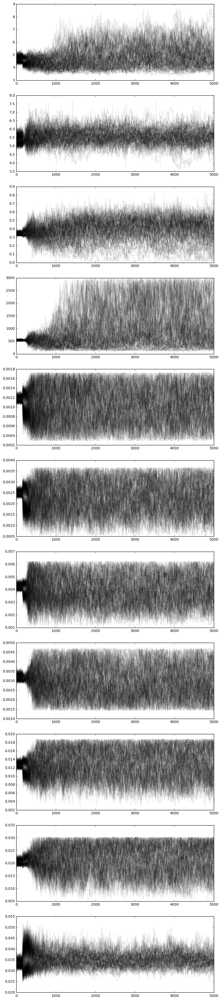

In [19]:
fig = plt.figure(figsize=(10,50))
for i in range(11):
    ax1 = fig.add_subplot(11,1,(i+1))
    ax1.plot(sampler.chain[:,:,i].T, '-', color='k', alpha=0.1);

In [35]:
samples = sampler.chain[:, 2000:, :].reshape((-1, ndim))

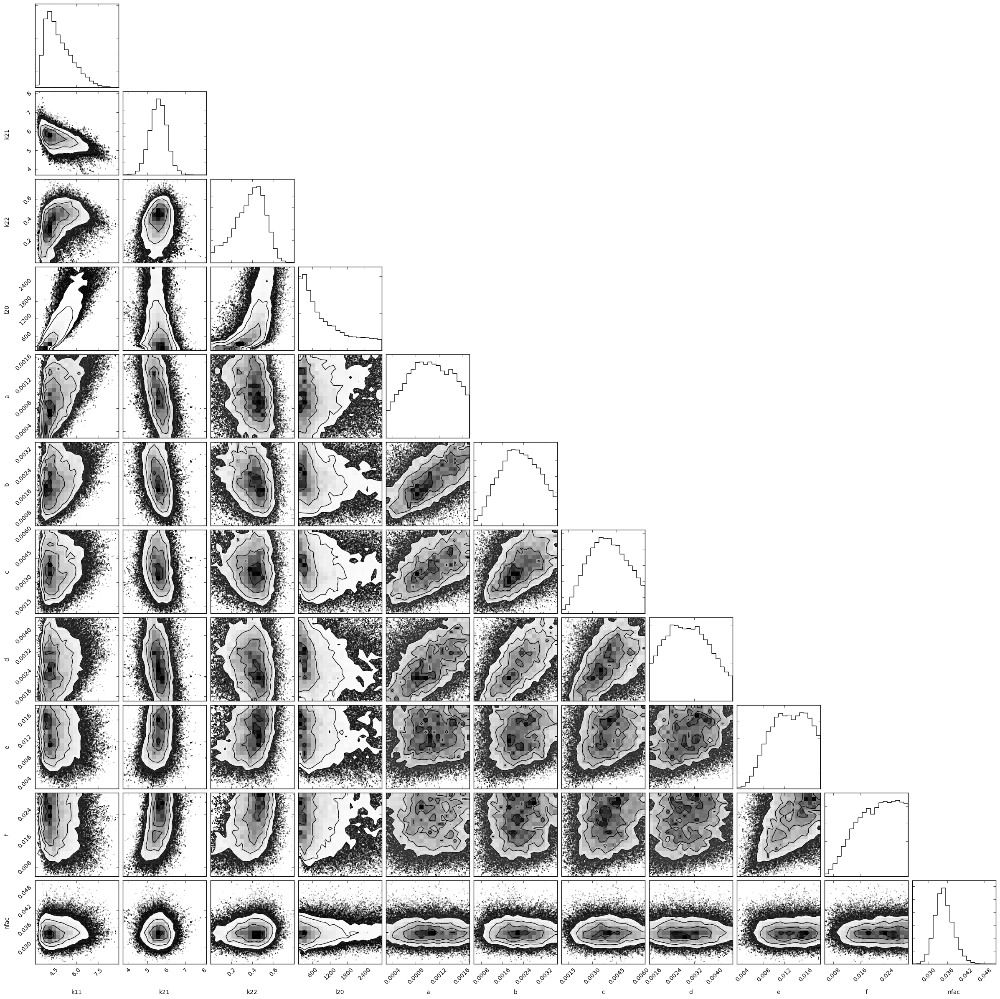

In [36]:
fig=corner.corner(samples, labels=['k11','k21','k22','l20','a','b','c','d','e','f','nfac'])

In [53]:
bnds_allfree2 = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (10., 5000.),
                 (0.00028499999999999999, 0.0034629221565530745),
 (0.00051000000000000004, 0.0073618293826193948),
 (0.00109, 0.012504982062515015),
 (0.0014250000000000001, 0.009421463307390637),
 (0.0027399999999999998, 0.037617956020509907),
 (0.0053, 0.060725288780766246),
                 (0.0001, 0.1))

In [54]:
pos2 = [np.random.normal(1.,0.1)*mlfit for i in range(nwalkers)]

In [55]:
sampler2 = emcee.EnsembleSampler(nwalkers,ndim,lnprob,args=(bnds_allfree2,WT_08_sat,WT_08_lig))

In [56]:
sampler2.run_mcmc(pos,5000);

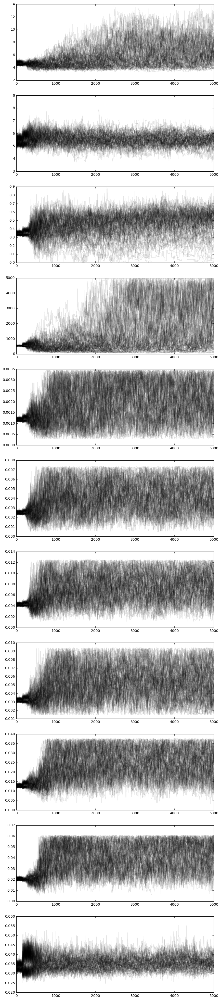

In [57]:
fig = plt.figure(figsize=(10,50))
for i in range(11):
    ax1 = fig.add_subplot(11,1,(i+1))
    ax1.plot(sampler2.chain[:,:,i].T, '-', color='k', alpha=0.1);

In [58]:
samples2 = sampler2.chain[:, 2000:, :].reshape((-1, ndim))

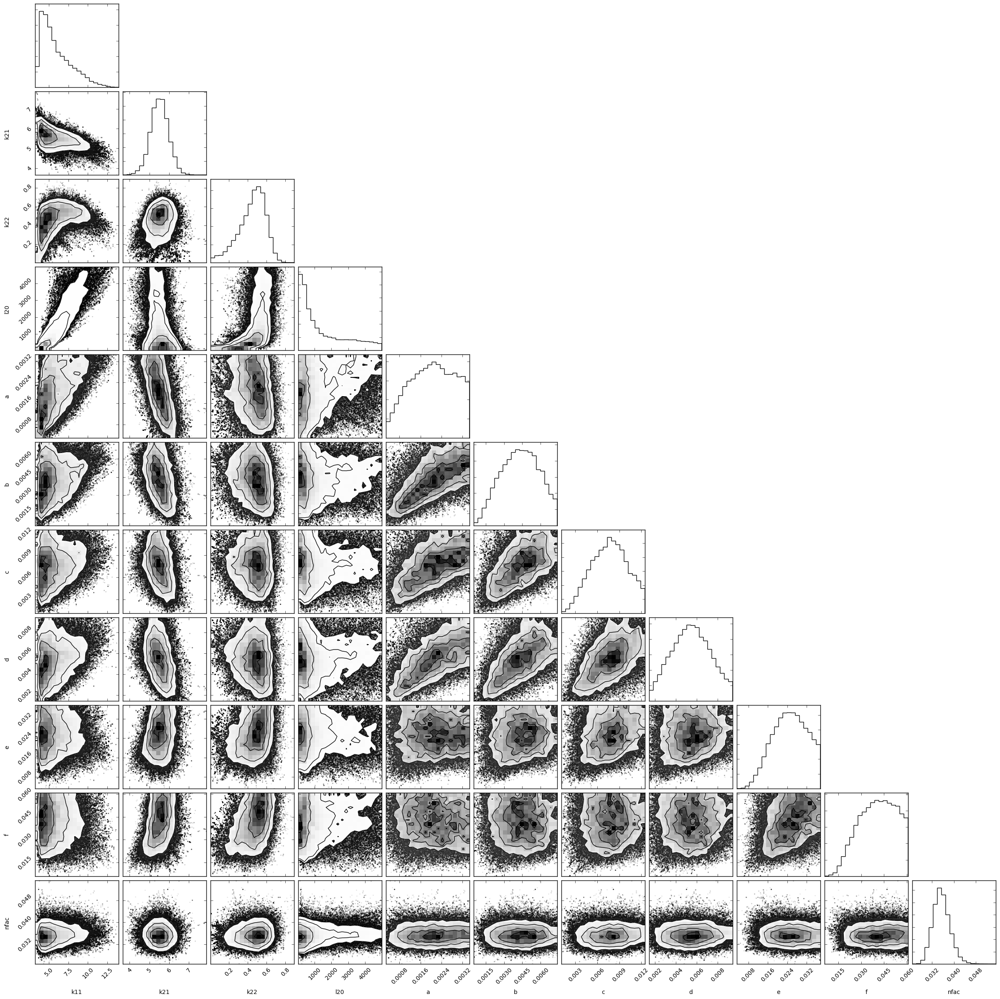

In [59]:
fig=corner.corner(samples2, labels=['k11','k21','k22','l20','a','b','c','d','e','f','nfac'])

In [60]:
samples2.shape

(300000, 11)

In [70]:
meds = [np.median(samples2[:,i]) for i in range(11)]

In [69]:
[np.mean(samples2[:,i]) for i in range(11)]

[5.9736512635209529,
 5.5170227578602322,
 0.44557641453817864,
 1461.8287462114811,
 0.0020415010571730031,
 0.004327414638032454,
 0.0076544215319944717,
 0.0054674530300281819,
 0.025048903140885311,
 0.040814456984497975,
 0.035480910578145917]

In [71]:
meds[4:-1]

[0.0020624622626065829,
 0.0043495617745839855,
 0.0077142417271564272,
 0.0054555744207750905,
 0.025181295137558561,
 0.041348691517510229]

In [72]:
guess[4:-1]

array([ 0.00057,  0.00102,  0.00218,  0.00285,  0.00548,  0.0106 ])

In [73]:
mlfit[4:-1]

array([ 0.00115431,  0.00245394,  0.00416833,  0.00314049,  0.01253932,
        0.02024176])

In [74]:
mlfit[0:4]

array([  4.60000000e+00,   5.30000000e+00,   3.40000000e-01,
         5.30000000e+02])

In [75]:
meds[0:4]

[5.422395263284149,
 5.5171090145055643,
 0.46858175686080539,
 874.85818633761994]

{'boxes': [<matplotlib.lines.Line2D at 0x11ca98320>],
 'caps': [<matplotlib.lines.Line2D at 0x11c60dcc0>,
 'fliers': [<matplotlib.lines.Line2D at 0x11caadc50>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x11caa6320>],
 'whiskers': [<matplotlib.lines.Line2D at 0x11ca98f60>,
  <matplotlib.lines.Line2D at 0x11c4fb358>]}

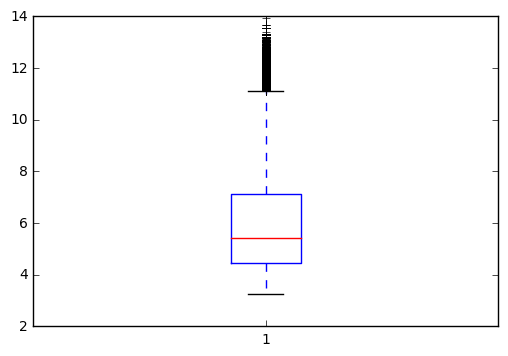

In [76]:
plt.boxplot(samples2[:,0])

In [81]:
v = (np.percentile(samples2, [16, 50, 84], axis=0))

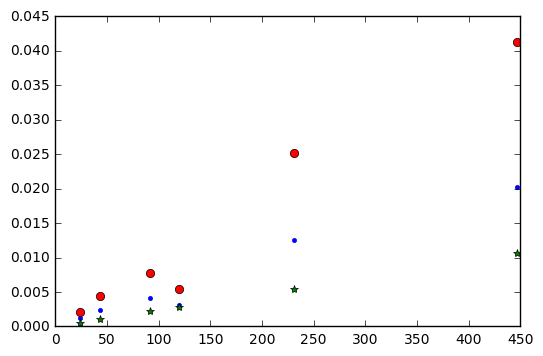

In [85]:
cellct = np.array([24.,43.,92.,120.,231.,447.])
plt.plot(cellct, mlfit[4:-1],'.')
plt.plot(cellct, guess[4:-1],'*')
plt.plot(cellct, meds[4:-1],'o')

In [92]:
v[1], v[2] - v[1], v[1]-v[0]

(array([  5.42239526e+00,   5.51710901e+00,   4.68581757e-01,
          8.74858186e+02,   2.06246226e-03,   4.34956177e-03,
          7.71424173e-03,   5.45557442e-03,   2.51812951e-02,
          4.13486915e-02,   3.53014685e-02]),
 array([  2.62982032e+00,   4.35935490e-01,   1.12857334e-01,
          2.31440034e+03,   9.11002106e-04,   1.63283289e-03,
          2.51243855e-03,   1.94270763e-03,   7.49844380e-03,
          1.24184435e-02,   3.17914446e-03]),
 array([  1.24248998e+00,   4.27187637e-01,   1.68362400e-01,
          6.35851165e+02,   9.40434043e-04,   1.67767812e-03,
          2.64004953e-03,   1.92479036e-03,   7.55370851e-03,
          1.33556003e-02,   2.84772327e-03]))

In [93]:
v[0],v[1],v[2]

(array([  4.17990528e+00,   5.08992138e+00,   3.00219357e-01,
          2.39007022e+02,   1.12202822e-03,   2.67188365e-03,
          5.07419220e-03,   3.53078407e-03,   1.76275866e-02,
          2.79930912e-02,   3.24537452e-02]),
 array([  5.42239526e+00,   5.51710901e+00,   4.68581757e-01,
          8.74858186e+02,   2.06246226e-03,   4.34956177e-03,
          7.71424173e-03,   5.45557442e-03,   2.51812951e-02,
          4.13486915e-02,   3.53014685e-02]),
 array([  8.05221558e+00,   5.95304450e+00,   5.81439091e-01,
          3.18925853e+03,   2.97346437e-03,   5.98239466e-03,
          1.02266803e-02,   7.39828205e-03,   3.26797389e-02,
          5.37671350e-02,   3.84806130e-02]))

In [94]:
meds[4]

0.0020624622626065829

In [95]:
v[0][4]

0.001122028220106268

In [96]:
v[1][4]

0.0020624622626065829

In [103]:
v[0][4:-1]

array([ 0.00112203,  0.00267188,  0.00507419,  0.00353078,  0.01762759,
        0.02799309])

In [98]:
mlfit[4:-1]

array([ 0.00115431,  0.00245394,  0.00416833,  0.00314049,  0.01253932,
        0.02024176])

In [104]:
tuple(i for i in zip(v[0][4:-1],v[2][4:-1]))

((0.001122028220106268, 0.0029734643688505698),
 (0.0026718836495931994, 0.0059823946612194857),
 (0.0050741921991039884, 0.010226680281239724),
 (0.0035307840655927868, 0.0073982820480301553),
 (0.017627586623114175, 0.032679738938729268),
 (0.027993091170371107, 0.053767135016462977))

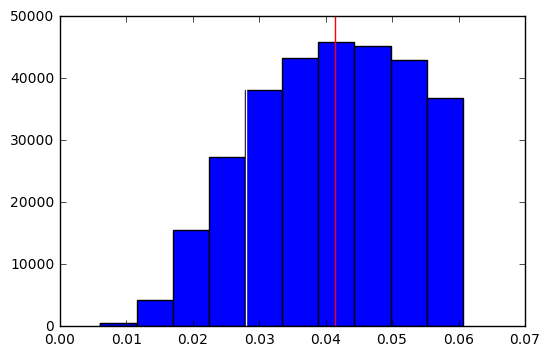

In [111]:
plt.hist(samples2[:,-2])
plt.axvline(meds[-2],color='red')
plt.axvline(v[0][-2],color='white')

In [112]:
bnds_allfree3 = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (10., 5000.),
                 (0.001122028220106268, 0.0029734643688505698),
 (0.0026718836495931994, 0.0059823946612194857),
 (0.0050741921991039884, 0.010226680281239724),
 (0.0035307840655927868, 0.0073982820480301553),
 (0.017627586623114175, 0.032679738938729268),
 (0.027993091170371107, 0.053767135016462977),
                 (0.0001, 0.1))

In [115]:
pos3 = [np.random.normal(1.,0.1)*np.array(meds) for i in range(nwalkers)]

In [116]:
sampler3 = emcee.EnsembleSampler(nwalkers,ndim,lnprob,args=(bnds_allfree3,WT_08_sat,WT_08_lig))

In [117]:
sampler3.run_mcmc(pos3,5000);

In [118]:
labels=['k11','k21','k22','l20','a','b','c','d','e','f','nfac']

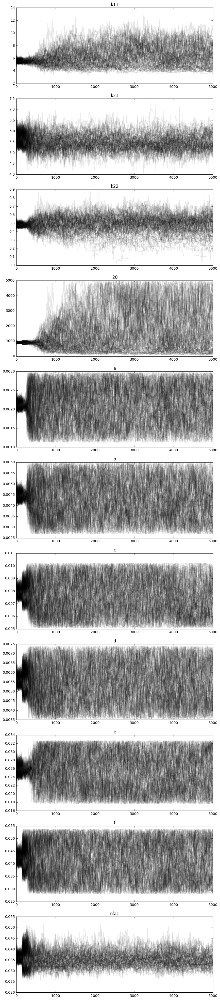

In [119]:
fig = plt.figure(figsize=(10,50))
for i in range(11):
    ax1 = fig.add_subplot(11,1,(i+1))
    ax1.plot(sampler3.chain[:,:,i].T, '-', color='k', alpha=0.1);
    ax1.set_title(labels[i])

In [120]:
samples3 = sampler3.chain[:, 2000:, :].reshape((-1, ndim))

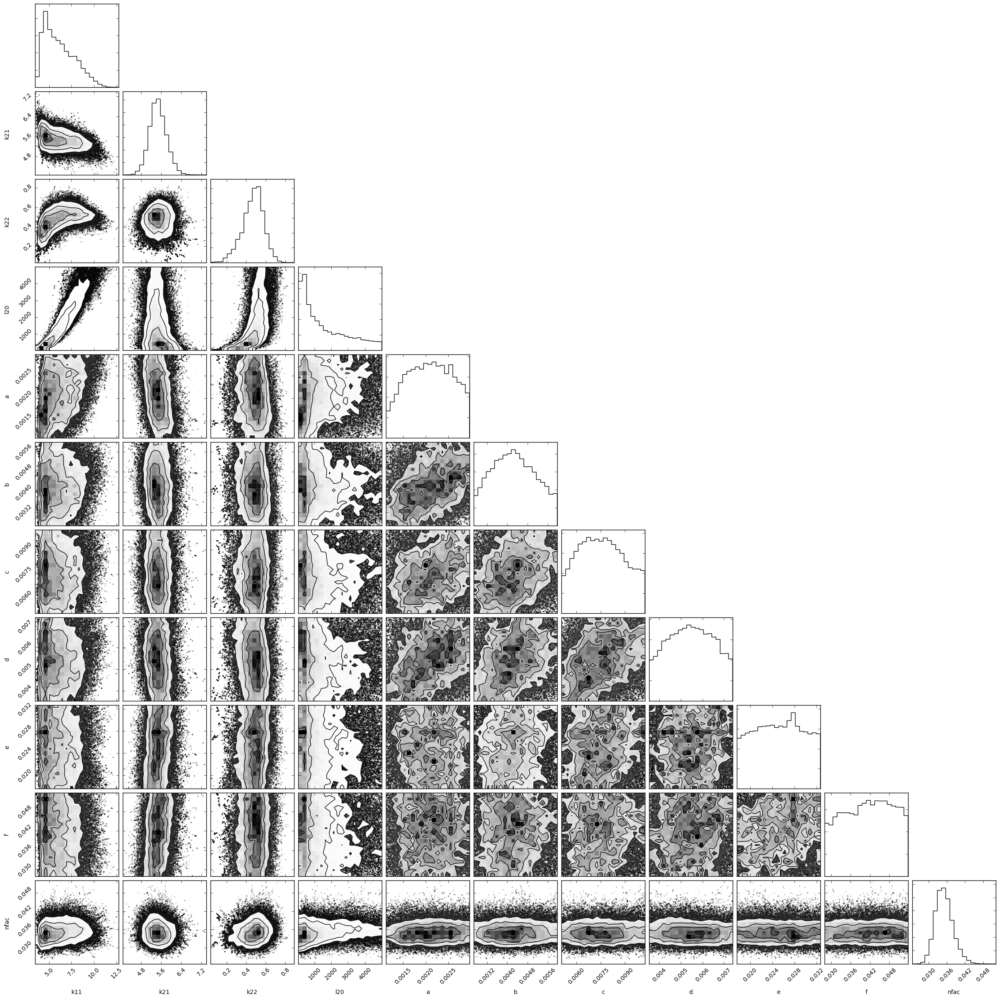

In [121]:
fig=corner.corner(samples3, labels=['k11','k21','k22','l20','a','b','c','d','e','f','nfac'])

In [123]:
np.median(samples3,axis=0)

array([  5.84690604e+00,   5.45969532e+00,   4.80612278e-01,
         1.08375719e+03,   2.09226220e-03,   4.24340251e-03,
         7.53660791e-03,   5.47103889e-03,   2.52905591e-02,
         4.16420195e-02,   3.48926829e-02])

In [124]:
[np.median(samples3[:,i]) for i in range(11)]

[5.8469060414797616,
 5.4596953243878206,
 0.48061227781409921,
 1083.7571919716636,
 0.0020922622015899653,
 0.004243402508425643,
 0.0075366079081729768,
 0.005471038891141874,
 0.025290559060449684,
 0.041642019535693048,
 0.034892682943861886]

In [125]:
meds

[5.422395263284149,
 5.5171090145055643,
 0.46858175686080539,
 874.85818633761994,
 0.0020624622626065829,
 0.0043495617745839855,
 0.0077142417271564272,
 0.0054555744207750905,
 0.025181295137558561,
 0.041348691517510229,
 0.035301468494939113]

In [134]:
tuple(i for i in zip(v[1][4:-1],v[1][4:-1]+0.00001))

((0.0020624622626065829, 0.0020724622626065829),
 (0.0043495617745839855, 0.0043595617745839851),
 (0.0077142417271564272, 0.0077242417271564268),
 (0.0054555744207750905, 0.0054655744207750901),
 (0.025181295137558561, 0.025191295137558561),
 (0.041348691517510229, 0.041358691517510232))

In [135]:
bnds_fixr = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (10., 5000.),
                 (0.0020624622626065829, 0.0020724622626065829),
 (0.0043495617745839855, 0.0043595617745839851),
 (0.0077142417271564272, 0.0077242417271564268),
 (0.0054555744207750905, 0.0054655744207750901),
 (0.025181295137558561, 0.025191295137558561),
 (0.041348691517510229, 0.041358691517510232),
                 (0.0001, 0.1))

In [136]:
sampler4 = emcee.EnsembleSampler(nwalkers,ndim,lnprob,args=(bnds_fixr,WT_08_sat,WT_08_lig))

In [137]:
sampler4.run_mcmc(pos3,5000);  #positions are out of bounds

/Users/michael/miniconda3/envs/fitter/lib/python3.5/site-packages/emcee-2.2.1-py3.5.egg/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob - lnprob0
/Users/michael/miniconda3/envs/fitter/lib/python3.5/site-packages/emcee-2.2.1-py3.5.egg/emcee/ensemble.py:336: RuntimeWarning: invalid value encountered in greater
  accept = (lnpdiff > np.log(self._random.rand(len(lnpdiff))))


emcee: Exception while calling your likelihood function:
  params: [  5.42754122e+00   5.51927813e+00   4.68720096e-01   8.75343250e+02
   2.06263750e-03   4.35109976e-03   7.71613541e-03   5.45674058e-03
   2.51899830e-02   4.13585675e-02   3.53171747e-02]
  args: (((0.01, 100.0), (0.01, 100.0), (0.001, 10.0), (10.0, 5000.0), (0.002062462262606583, 0.002072462262606583), (0.0043495617745839855, 0.004359561774583985), (0.007714241727156427, 0.007724241727156427), (0.0054555744207750905, 0.00546557442077509), (0.02518129513755856, 0.02519129513755856), (0.04134869151751023, 0.04135869151751023), (0.0001, 0.1)), array([ array([ 0.04603855,  0.07301927,  0.1115632 ,  0.1925054 ,  0.2426124 ,
        0.3466809 ,  0.4411135 ,  0.5066381 ,  0.7147752 ,  0.8130621 ,
        0.8535332 ,  0.8901499 ,  0.8997859 ,  0.9460385 ,  0.9961456 ]),
       array([ 0.03062099,  0.05952891,  0.09614561,  0.1732334 ,  0.2310493 ,
        0.337045  ,  0.4565311 ,  0.5683084 ,  0.6588865 ,  0.8053533 ,
     

Traceback (most recent call last):
  File "/Users/michael/miniconda3/envs/fitter/lib/python3.5/site-packages/emcee-2.2.1-py3.5.egg/emcee/ensemble.py", line 519, in __call__
    return self.f(x, *self.args, **self.kwargs)
  File "<ipython-input-6-456da5401164>", line 5, in lnprob
    return lp + lnlik(allfit,data,ligs)
  File "<ipython-input-4-c34b5c97a6aa>", line 8, in lnlik
    model = ligbind.models.wymfunc(modparms,ligs,rtots)
  File "./ligbind/ligbind/models.py", line 35, in wymfunc
    8.*l20*rtot*(1 + k21*lig + k21*k22*(np.square(lig)))))**0.5) \
KeyboardInterrupt


KeyboardInterrupt: 

In [147]:
a = np.random.normal(1,0.1,11)
a[4:-1] = 1
a

array([ 0.88280156,  0.99212104,  0.96623779,  1.06903348,  1.        ,
        1.        ,  1.        ,  1.        ,  1.        ,  1.        ,
        0.76553418])

In [151]:
np.put(np.random.normal(1,0.1,11),[4,5],1)

TypeError: unsupported operand type(s) for *: 'NoneType' and 'int'

In [158]:
nll = lambda x: np.random.normal(1,0.1)

In [159]:
nll

<function __main__.<lambda>>

In [179]:
#vary all Wym model parameters
#variance weighted by y-value (not y squared)
def lnlik4p(parms,rtot,data,ligs):
    datac = np.concatenate(data)
    modparms = parms
    rtots = rtot
    f = parms[-1]
    model = ligbind.models.wymfunc(modparms,ligs,rtots)
    invsig2 = 1.0/np.square(f * np.sqrt(model))
    return -0.5*(np.sum((datac-model)**2*invsig2 - np.log(invsig2)))

In [162]:
#uniform prior based on bounds
def lnpri4p(allfit,bounds):
    assert len(bounds) == len(allfit)
    if all([bounds[i][0] <= allfit[i] <= bounds[i][1] for i in range(len(bounds))]) is True:
        return 0.0
    else:
        return -np.inf

In [187]:
def lnprob4p(allfit,bounds,rtot,data,ligs):
    lp = lnpri4p(allfit,bounds)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlik4p(allfit,rtot,data,ligs)

In [191]:
nll4p = lambda *args: -lnlik4p(*args)

In [181]:
med_rtots = np.array(meds[4:-1])

In [182]:
med_rtots

array([ 0.00206246,  0.00434956,  0.00771424,  0.00545557,  0.0251813 ,
        0.04134869])

In [183]:
med_parms = np.append(meds[0:4],meds[-1])


In [184]:
lnlik4p(med_parms,med_rtots,WT_08_sat,WT_08_lig)

273.90729780287938

In [185]:
bnds4p = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (10., 5000.),
                 (0.0001, 0.1))

In [188]:
lnpri4p(med_parms,bnds4p)

0.0

In [189]:
lnprob4p(med_parms,bnds4p,med_rtots,WT_08_sat,WT_08_lig)

273.90729780287938

In [193]:
nll4p(med_parms,med_rtots,WT_08_sat,WT_08_lig)

-273.90729780287938

In [197]:
nll_res4p = optimize.minimize(nll4p,med_parms,bounds=bnds4p,args=(med_rtots,WT_08_sat,WT_08_lig))

In [200]:
nll_res4p.x

array([  5.64400519e+00,   5.45183002e+00,   4.71388242e-01,
         8.74857647e+02,   3.33470592e-02])

In [196]:
med_parms

array([  5.42239526e+00,   5.51710901e+00,   4.68581757e-01,
         8.74858186e+02,   3.53014685e-02])

In [202]:
ndim4p, nwalkers4p = 5, 100
pos4p = [np.random.normal(1.,0.1)*nll_res4p.x for i in range(nwalkers4p)]

In [210]:
sampler = emcee.EnsembleSampler(nwalkers4p,ndim4p,lnprob4p,args=(bnds4p,med_rtots,WT_08_sat,WT_08_lig))

In [211]:
sampler.run_mcmc(pos4p,5000);

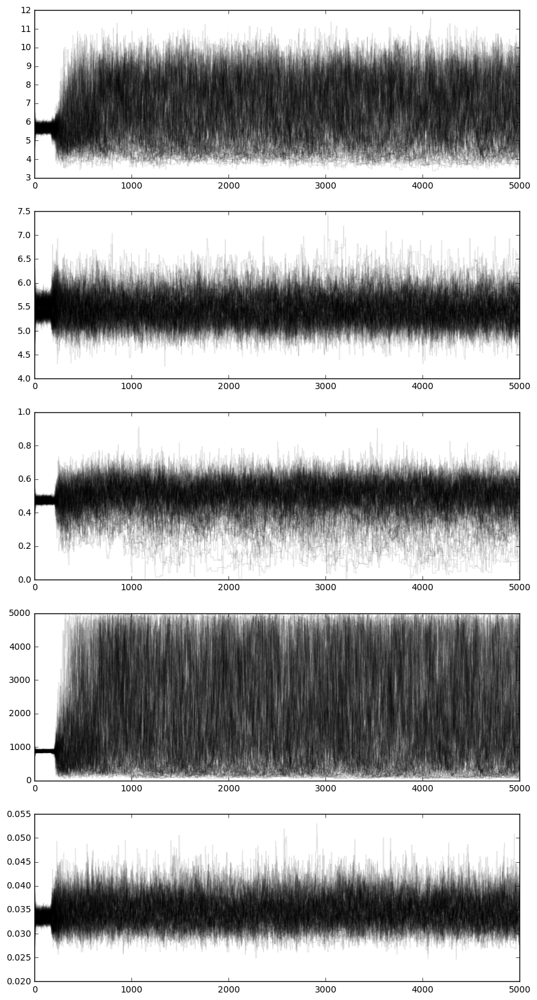

In [212]:
fig = plt.figure(figsize=(10,20))
for i in range(5):
    ax1 = fig.add_subplot(5,1,(i+1))
    ax1.plot(sampler.chain[:,:,i].T, '-', color='k', alpha=0.1);

In [214]:
samples = sampler.chain[:, 2000:, :].reshape((-1, ndim4p))

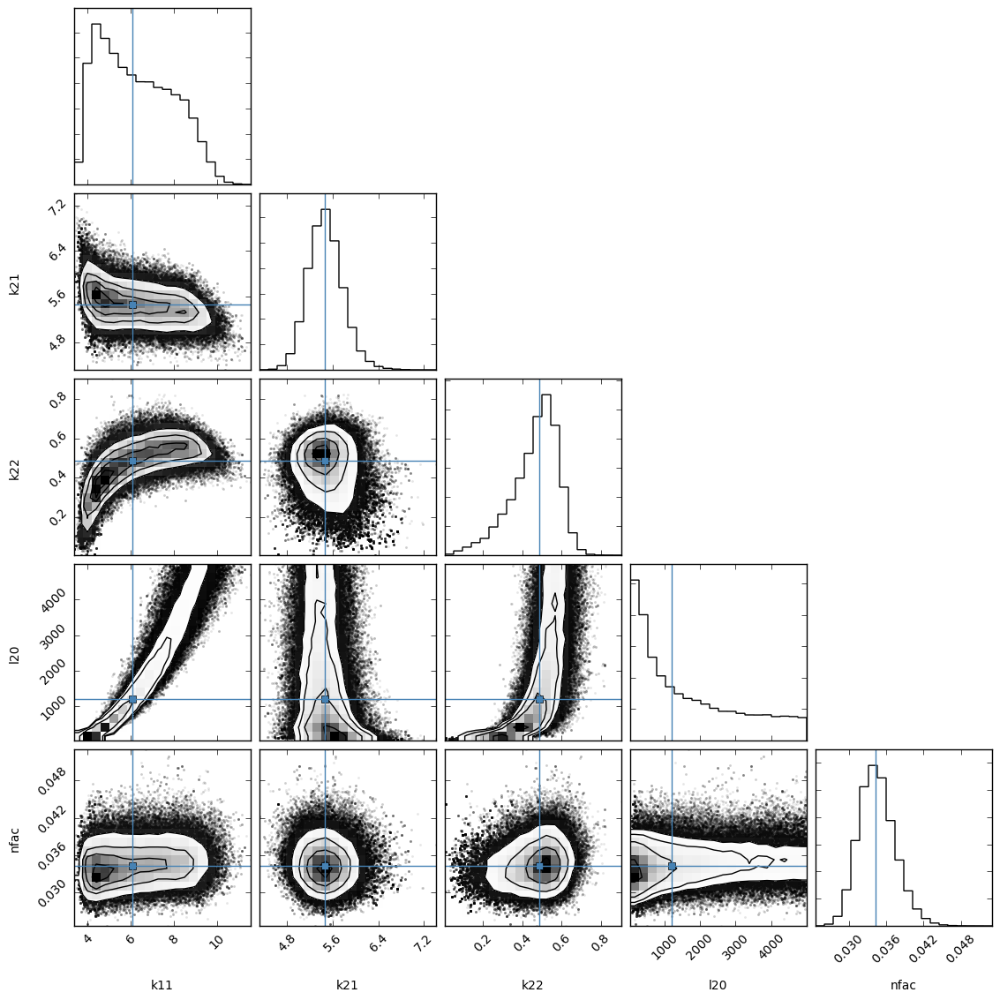

In [217]:
fig=corner.corner(samples, labels=['k11','k21','k22','l20','nfac'],truths=np.median(samples,axis=0))

In [216]:
np.median(samples,axis=0)

array([  6.06155345e+00,   5.46138867e+00,   4.85708817e-01,
         1.19705194e+03,   3.43705961e-02])

In [232]:
bnds5p = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (0.01, 10000.),
                 (0.0001, 0.1))

In [233]:
sampler5p = emcee.EnsembleSampler(nwalkers4p,ndim4p,lnprob4p,args=(bnds5p,med_rtots,WT_08_sat,WT_08_lig))

In [234]:
sampler5p.run_mcmc(pos4p,5000);

In [235]:
samples5p = sampler5p.chain[:, 2000:, :].reshape((-1, ndim4p))

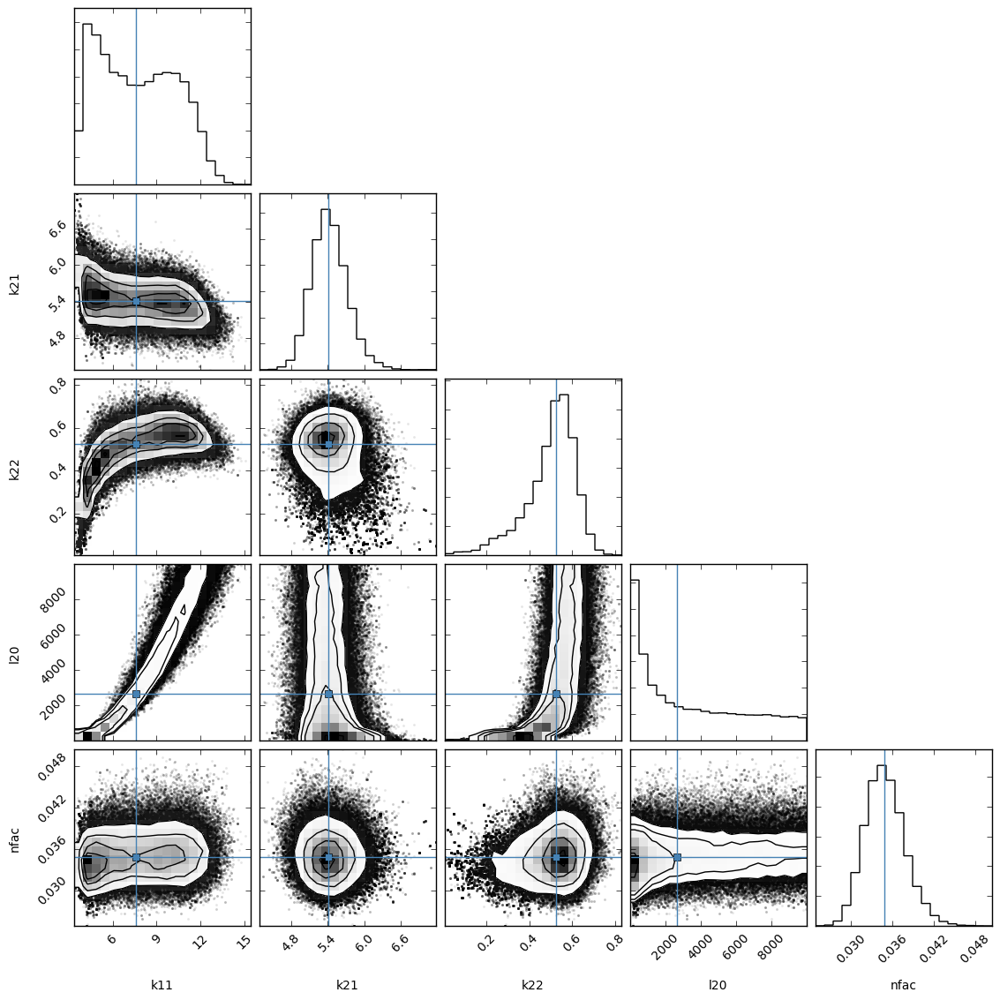

In [236]:
fig5p=corner.corner(samples5p, labels=['k11','k21','k22','l20','nfac'],truths=np.median(samples5p,axis=0))

In [237]:
bnds6p = ((0.01, 100.),
                 (0.01, 100.),
                 (0.001, 10.),
                 (100, 5000.),
                 (0.0001, 0.1))

In [239]:
sampler6p = emcee.EnsembleSampler(nwalkers4p,ndim4p,lnprob4p,args=(bnds6p,med_rtots,WT_08_sat,WT_08_lig))

In [240]:
sampler6p.run_mcmc(pos4p,5000);

In [242]:
samples6p = sampler6p.chain[:, 2000:, :].reshape((-1, ndim4p))

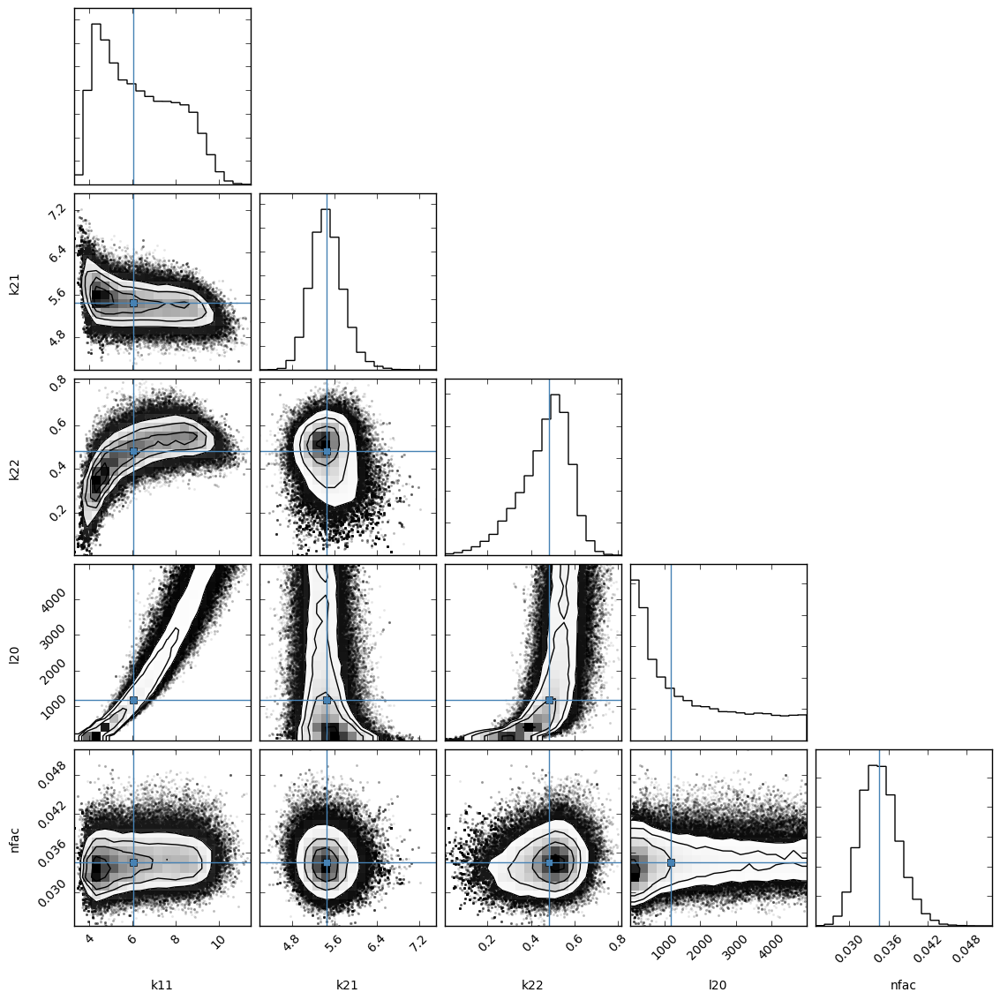

In [244]:
fig6p=corner.corner(samples6p, labels=['k11','k21','k22','l20','nfac'],truths=np.median(samples6p,axis=0))

In [246]:
med_rtots

array([ 0.00206246,  0.00434956,  0.00771424,  0.00545557,  0.0251813 ,
        0.04134869])

In [247]:
def dimfun(rtot,l20):
    k = 1/l20
    a = 4.
    b = -(4.*rtot + k)
    c = rtot**2
    rad = np.sqrt(b**2 - 4*a*c)
    
    D = (-b - rad)/(2*a)
    
    return D, 2*D/rtot

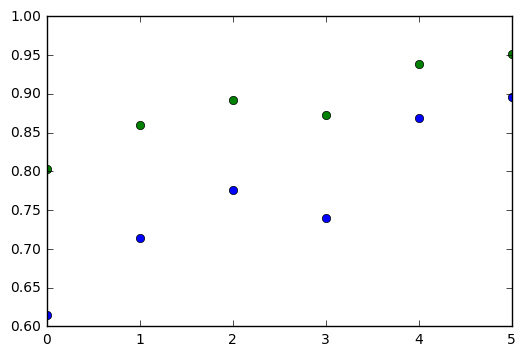

In [254]:
plt.plot(dimfun(med_rtots,1000.)[1],'o')
plt.plot(dimfun(med_rtots,5000.)[1],'o')

(array([  113.,     0.,    88.,   155.,   104.,   243.,   289.,   433.,
          457.,   638.,   559.,   879.,   748.,   859.,  1254.,   814.,
          978.,  1170.,  1442.,  1036.,  1090.,  1414.,  1147.,  1549.,
         1136.,  1336.,  1356.,  1378.,  1491.,  1426.,  1479.,  1420.,
         1636.,  1373.,  1523.,  1508.,  1120.,  1398.,  1231.,  1198.,
         1259.,  1226.,  1121.,  1204.,  1371.,  1270.,  1167.,  1070.,
          990.,  1030.,  1160.,  1242.,  1089.,  1027.,   976.,  1062.,
         1054.,   963.,   951.,  1116.,   843.,   945.,  1135.,   986.,
         1032.,   948.,   897.,   840.,   993.,   943.,   838.,   829.,
          866.,   890.,   727.,   822.,   809.,   798.,   869.,   735.,
          825.,   710.,   659.,   720.,   681.,   627.,   690.,   594.,
          773.,   692.,   705.,   780.,   732.,   800.,   668.,   711.,
          616.,   718.,   591.,   681.,   582.,   611.,   628.,   652.,
          564.,   636.,   538.,   549.,   676.,   629.,   624., 

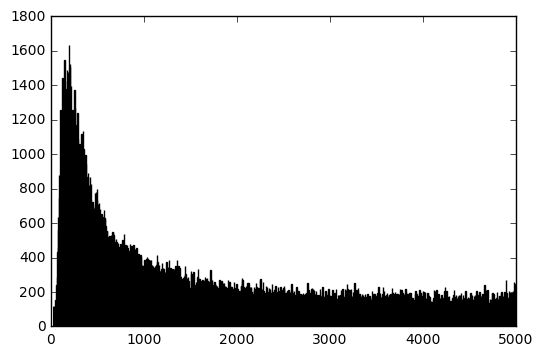

In [259]:
plt.hist(samples6p[:,3],bins=1000)

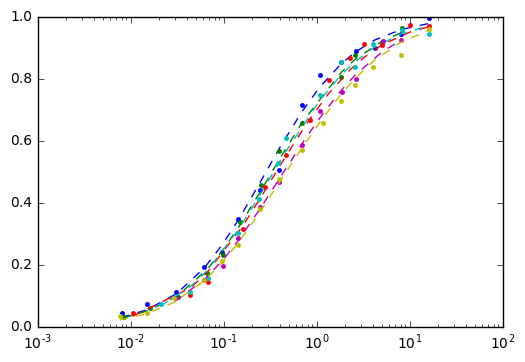

In [260]:
plotter.viewf(ligbind.models.wymfunc,np.median(samples6p[:-1],axis=0),WT_08_lig,WT_08_sat,med_rtots)

In [261]:
from scipy.stats.kde import gaussian_kde

ValueError: x and y must have same first dimension

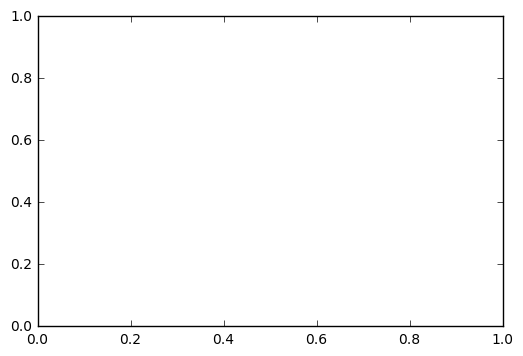

In [265]:
from scipy import stats

In [266]:
stats.mode(samples6p[:,3])

KeyboardInterrupt: 

In [275]:
thing = np.histogram(samples6p[:,3],bins=10000)

In [276]:
np.argmax(thing[0])

352

In [277]:
thing[0][352]

255

In [279]:
thing[0][353]

118

In [283]:
thing[2][354]

IndexError: tuple index out of range

In [289]:
hist, binedg = np.histogram(samples6p[:,3],bins=1000)

In [290]:
hist, binedg

(array([ 113,    0,   88,  155,  104,  243,  289,  433,  457,  638,  559,
         879,  748,  859, 1254,  814,  978, 1170, 1442, 1036, 1090, 1414,
        1147, 1549, 1136, 1336, 1356, 1378, 1491, 1426, 1479, 1420, 1636,
        1373, 1523, 1508, 1120, 1398, 1231, 1198, 1259, 1226, 1121, 1204,
        1371, 1270, 1167, 1070,  990, 1030, 1160, 1242, 1089, 1027,  976,
        1062, 1054,  963,  951, 1116,  843,  945, 1135,  986, 1032,  948,
         897,  840,  993,  943,  838,  829,  866,  890,  727,  822,  809,
         798,  869,  735,  825,  710,  659,  720,  681,  627,  690,  594,
         773,  692,  705,  780,  732,  800,  668,  711,  616,  718,  591,
         681,  582,  611,  628,  652,  564,  636,  538,  549,  676,  629,
         624,  581,  554,  557,  556,  512,  520,  507,  466,  471,  526,
         520,  520,  532,  485,  412,  549,  551,  536,  531,  510,  488,
         448,  485,  507,  488,  468,  420,  483,  455,  453,  461,  461,
         414,  477,  472,  461,  385, 

In [291]:
hist.size

1000

In [292]:
binedg.size

1001

In [293]:
hist[0]

113

In [294]:
np.argmax(hist)

32

In [296]:
binedg[32],binedg[33]

(189.13725481415872, 194.10693371227626)

In [300]:
a = [np.histogram(samples6p[:,i], bins=1000) for i in range(5)]

In [308]:
a[4][2]

IndexError: tuple index out of range

In [1]:
med_rt

NameError: name 'med_rt' is not defined

In [ ]:
med